In [1]:

import os
import sys
import random
import time
from datetime import datetime
import logging
import argparse
import traceback
import matplotlib.pyplot as plt

import torch
from torch import nn

import numpy as np
import pandas as pd
import scipy

import datasource_mesa, datasource_slpdb, datasource_mitdb, vae_model, fn_loss

In [2]:

def viz_epoch_batch(epoch, x_batch, x_hat_batch, log_filename):
    folder = os.path.join("logs", "recon_vae", log_filename)
    if not os.path.exists(folder):
        os.makedirs(folder)
    x_batch = x_batch.detach().cpu().numpy()
    x_hat_batch = x_hat_batch.detach().cpu().numpy()
    for i in range(2):
        orig = x_batch[i, 0, :]
        recon = x_hat_batch[i, 0, :]
        _, ax = plt.subplots()
        ax.plot(range(len(orig)), orig)
        # plt.savefig(
        #     f"{folder}/epoch{epoch}_item{i}_orig.png",
        #     format='png', dpi=300, bbox_inches='tight')
        ax.plot(range(len(recon)), recon)
        # plt.ylim((0, 2)) 
        plt.savefig(
            f"{folder}/epoch{epoch}_item{i}.png",
            format='png', dpi=300, bbox_inches='tight')
    plt.close()


logger = logging.getLogger(__name__)


def log(msg):
    logger.debug(msg)


def config_logger(log_file):
    r"""Config logger."""
    global logger
    logger.handlers.clear()
    logger.setLevel(logging.DEBUG)

    # create console handler and set level to debug
    ch = logging.StreamHandler()
    ch.setLevel(logging.DEBUG)

    format = logging.Formatter(
        "%(asctime)s - %(name)s - %(levelname)s - %(message)s")
    ch.setFormatter(format)
    # ch.setLevel(logging.DEBUG)
    logger.addHandler(ch)
    # logging.basicConfig(format=format, level=logging.DEBUG, datefmt="%H:%M:%S")
    # logger = logging.getLogger(__name__)

    # create file handler which logs even debug messages
    fh = logging.FileHandler(log_file)
    fh.setFormatter(format)
    # fh.setLevel(logging.DEBUG)
    # add the handlers to the logger
    
    logger.addHandler(fh)

In [6]:
Hz = 64
DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
SEG_LEN_SEC = 6
SEG_LEN = Hz*SEG_LEN_SEC

Reading 103.hea
dataset:300, segments:300


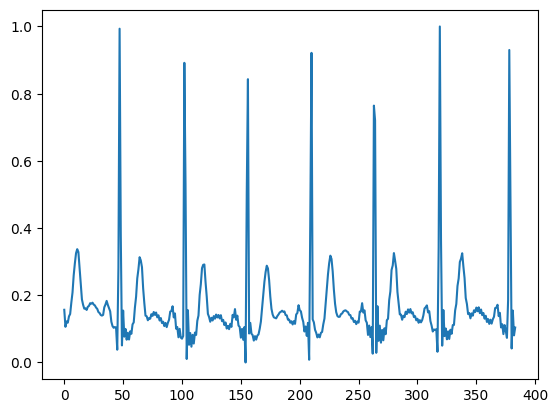

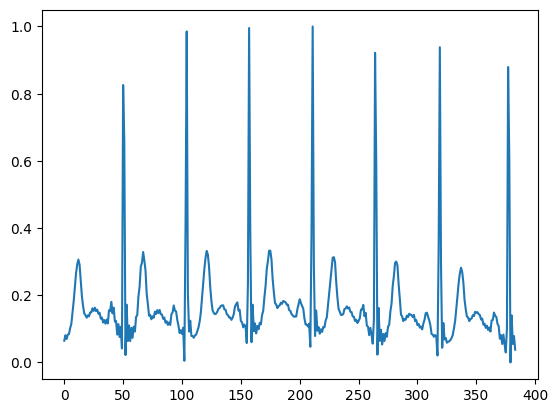

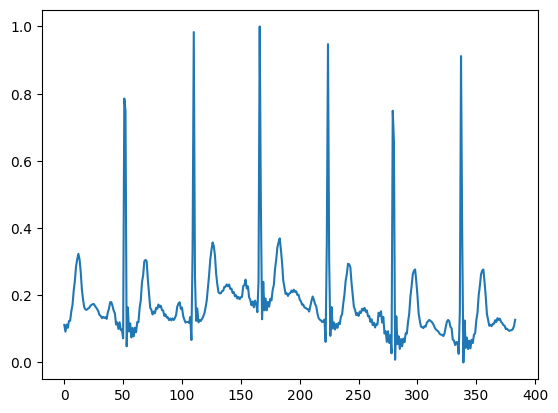

In [10]:
# DATA_PATH = "data/mesa/polysomnography/edfs/"
# segments, dataset = datasource_mesa.read_random_file_segments(
#     DATA_PATH, fs_target=Hz, seg_len=SEG_LEN, n_subject=1, ch_name='ekg'
# )
# datasource_mesa.query_channel_names(
#     DATA_PATH, fs_target=Hz, seg_len=SEG_LEN, n_subject=5, ch_name='EEG1'
# )

# DATA_PATH = f"{os. path. expanduser('~')}/data/physionet.org/files/slpdb/1.0.0/"
# segments, dataset = datasource_slpdb.read_repeated_segments(
#     DATA_PATH, fs_target=Hz, seg_len=SEG_LEN, n_segments=1000)
# segments, dataset = datasource_slpdb.read_random_file_segments(
#     DATA_PATH, fs_target=Hz, seg_len=SEG_LEN, n_subject=1)

DATA_PATH = f"{os. path. expanduser('~')}/data/physionet.org/files/mitdb/1.0.0/"
segments, dataset = datasource_mitdb.read_random_file_segments(
    DATA_PATH, fs_target=Hz, seg_len=SEG_LEN, n_subject=1, 
    filter_records=['103']
)

print(f"dataset:{len(dataset)}, segments:{len(segments)}")
for i in range(3):
    seg, lbl = dataset[i]
    seg = seg.flatten()
    plt.plot(range(len(seg)),seg)
    plt.show()

In [5]:
# filter = scipy.signal.firwin(400, [0.01, 10.0], pass_zero=False, fs=Hz)
# plt.plot(filter)
# plt.show()

# y = dataset[0][0].flatten()
# y2 = scipy.signal.convolve(y, filter, mode='same')
# plt.plot(range(len(y)), y)
# plt.show()
# plt.plot(range(len(y2)), y2)
# plt.show()

In [6]:
data_loader_train = torch.utils.data.DataLoader(
        dataset=dataset, batch_size=16, shuffle=True, drop_last=True)

In [7]:

# dataset = datasource_mesa.MesaDb(
#         base_data_dir="data/mesa/polysomnography", data_subdir="edfs", 
#         hz=Hz, class_map={0:0, 1:1, 2:1, 3:1, 5:1},
#         n_subjects=1, sig_modality='ekg', seg_sec=30, rr_seg_dim=256, is_rr_sig=False)   

# train_dataset = datasource_mesa.PartialDataset(
#                 dataset, seg_index=dataset.indexes, shuffle=True)
# data_loader_train = torch.utils.data.DataLoader(
#         dataset=train_dataset, batch_size=64, shuffle=True, drop_last=True)

In [8]:
# net = vae_model.RecurrentAutoencoder(seq_len=1, n_features=256, embedding_dim=64)
# print(net)

# tm_sim_start = f"{datetime.now():%Y%m%d%H%M%S}"

# optimizer = torch.optim.Adam(net.parameters(), lr=0.001)
# # criteria_decoder = nn.BCELoss()
# criteria_decoder = nn.MSELoss()
# # criteria_decoder = nn.L1Loss(reduction='sum')

# for epoch in range(200):
#     since = time.time()
#     train_loss = 0.
#     recon_loss = 0.
#     for i_batch, (inputs, labels) in enumerate(data_loader_train):
#         # inputs = inputs.to(device)
#         labels = labels.to(DEVICE)
        
#         x_src, x_ref = inputs[:, :1], inputs[:, 1:2]
#         x_src = x_src.to(DEVICE)
#         x_ref = x_ref.to(DEVICE)

#         optimizer.zero_grad()
#         x_hat = net(x_src)
#         # latent_ref, _, _ = net(x_ref)

#         # reconstruction loss
#         # loss_recon = ((x_src - x_hat)**2).mean()
#         loss_recon = criteria_decoder(x_hat, x_src)
#         # loss_recon = net.gaussian_likelihood(x_hat, x_src)

#         # elbo = (net.encoder.kl - loss_recon).mean()

#         # loss_recon = net.gaussian_likelihood(x_hat, x_src)
#         # elbo = (net.encoder.kl - loss_recon).mean()
#         # # loss_recon = ((x_src - x_hat)**2).sum() + net.encoder.kl   
        
#         loss = loss_recon 
#         # print(f"loss:{loss.shape} -> {loss.detach()}")
        
#         recon_loss += loss_recon.detach().mean().cpu().numpy()
#         train_loss += loss.detach().cpu().numpy()
#         # enc_d_loss += loss_enc_d.detach().cpu().numpy()

#         loss.backward()
#         optimizer.step()

#         if i_batch == 0 and epoch%10==0:
#             viz_epoch_batch(epoch, x_src, x_hat, tm_sim_start)
    
#     time_elapsed = time.time() - since
#     train_loss = train_loss / len(data_loader_train)
#     recon_loss = recon_loss / len(data_loader_train)
#     print(
#         f"epoch:{epoch}, train_loss:{train_loss:.4f}, "
#         f"recon_loss:{recon_loss:.4f}, "
#         f"time:{time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s")


In [9]:
input_dim = SEG_LEN
is_vae = True
input_split = SEG_LEN_SEC
# input_split = 1
n_block = 2
lr = 0.001

criteria_decoder = nn.BCELoss()
# criteria_decoder = nn.MSELoss()
# criteria_decoder = nn.L1Loss(reduction='sum')
# criteria_decoder = nn.L1Loss(reduction='mean')
# criteria_decoder = fn_loss.MMD_loss()


tm_sim_start = f"{datetime.now():%Y%m%d%H%M%S}"

log_file = f"logs/vaeExperiment_{DATA_PATH.replace('/', '')}_vae{is_vae}_block{n_block}_inputsplit{input_split}_seg{input_dim}_{criteria_decoder.__class__.__name__}_lr{lr}_{tm_sim_start}.log"
config_logger(log_file)

# net = vae_model.VAECnn(input_dim=input_dim, kernel_sz=11, n_class=2, is_cuda=False)

net = vae_model.FoldAE(
    input_dim=input_dim, kernel_sz=5, n_block=n_block, input_split=input_split, 
    vae_latent_dim=-1, n_class=2, is_cuda=DEVICE.type!='cpu', is_vae=is_vae, log=log)

# net = vae_model.VariationalAutoEncoder_MLP512(input_dim=256, latent_dim=128)

net.to(DEVICE)
log(net)
x = torch.randn(32, 1, input_dim)
_, x_hat = net(x.to(DEVICE))
print(f"x:{x.shape}, x_hat:{x_hat.shape}")

# warm_up_step = 10
# def lr_foo(epoch):
#     if epoch < warm_up_step:
#         # warm up lr
#         lr_scale = 0.1 ** (warm_up_step - epoch)
#     else:
#         lr_scale = 0.95 ** epoch
#     return lr_scale

optimizer = torch.optim.Adam(
    net.parameters(), 
    # list(net.encoder.parameters()) + list(net.decoder.parameters()),
    lr=lr)

# scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_foo)


2023-12-28 23:22:10,885 - __main__ - DEBUG - FoldAE(
  (encoder): FoldEncoder(
    (bn0): BatchNorm1d(1, eps=0.001, momentum=0.99, affine=True, track_running_stats=True)
    (encoder): Sequential(
      (0): Conv_block(
        (relu): LeakyReLU(negative_slope=0.01)
        (pool_op): Sequential()
        (conv): Conv1d(1, 8, kernel_size=(5,), stride=(2,), padding=(2,))
      )
      (1): Conv_block(
        (relu): LeakyReLU(negative_slope=0.01)
        (pool_op): Sequential()
        (conv): Conv1d(8, 8, kernel_size=(5,), stride=(2,), padding=(2,))
      )
    )
    (post_encoder): Sequential()
    (layer_mu): Linear(in_features=3840, out_features=1920, bias=True)
    (layer_sigma): Linear(in_features=3840, out_features=1920, bias=True)
  )
  (decoder): FoldDecoder(
    (pre_decoder): Sequential(
      (0): Linear(in_features=1920, out_features=3840, bias=True)
    )
    (decoder): Sequential(
      (0): Conv_block(
        (relu): LeakyReLU(negative_slope=0.01)
        (pool_op): Up

x:torch.Size([32, 1, 1920]), x_hat:torch.Size([32, 1, 1920])


2023-12-28 23:22:11,730 - __main__ - DEBUG - epoch:0, train_loss:352.9863, recon_loss:346.5780, elbo_loss:6.4084, lr:0.001, time:0m 1s
2023-12-28 23:22:12,400 - __main__ - DEBUG - epoch:1, train_loss:351.0453, recon_loss:346.5732, elbo_loss:4.4721, lr:0.001, time:0m 1s
2023-12-28 23:22:13,050 - __main__ - DEBUG - epoch:2, train_loss:347.7881, recon_loss:346.5766, elbo_loss:1.2115, lr:0.001, time:0m 1s
2023-12-28 23:22:13,735 - __main__ - DEBUG - epoch:3, train_loss:347.3756, recon_loss:346.5779, elbo_loss:0.7977, lr:0.001, time:0m 1s
2023-12-28 23:22:14,444 - __main__ - DEBUG - epoch:4, train_loss:347.5143, recon_loss:346.5706, elbo_loss:0.9437, lr:0.001, time:0m 1s
2023-12-28 23:22:15,137 - __main__ - DEBUG - epoch:5, train_loss:346.7495, recon_loss:346.5772, elbo_loss:0.1723, lr:0.001, time:0m 1s
2023-12-28 23:22:15,775 - __main__ - DEBUG - epoch:6, train_loss:346.7884, recon_loss:346.5785, elbo_loss:0.2099, lr:0.001, time:0m 1s
2023-12-28 23:22:16,404 - __main__ - DEBUG - epoch:7, t

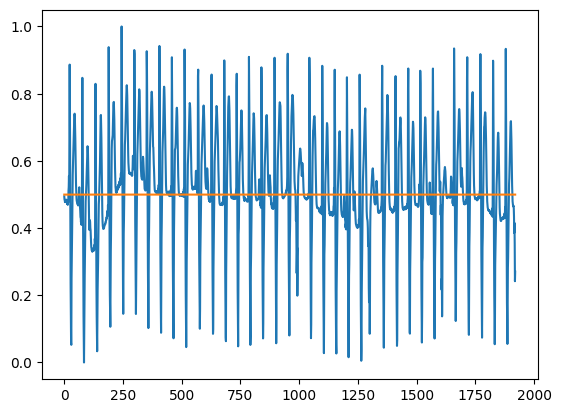

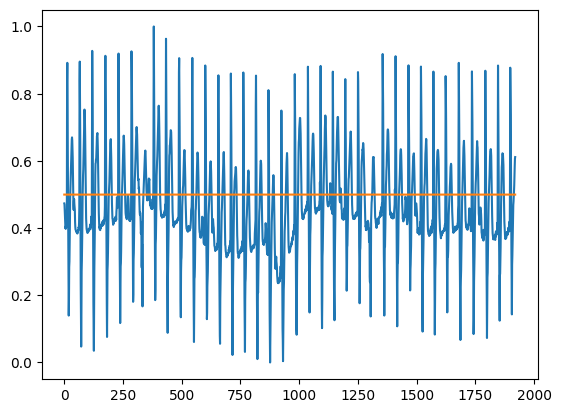

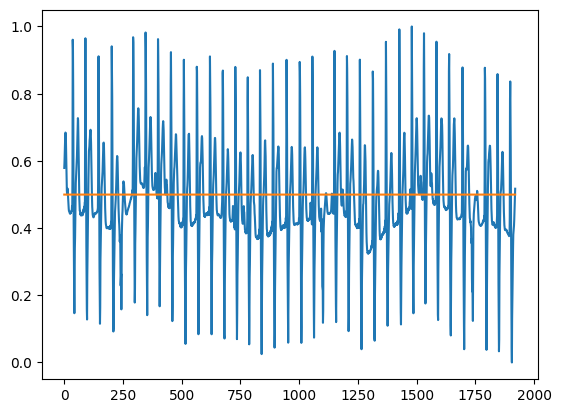

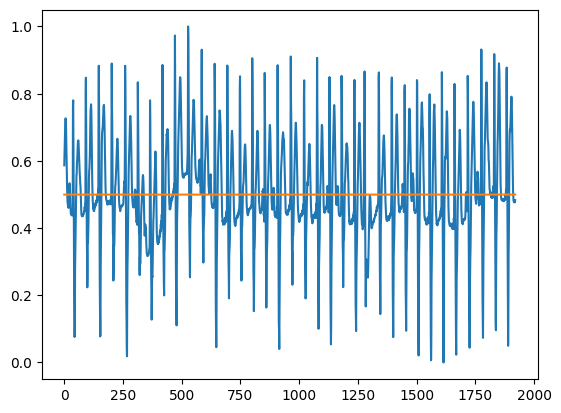

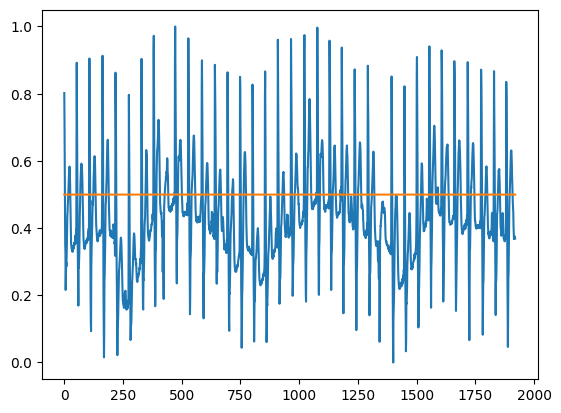

...

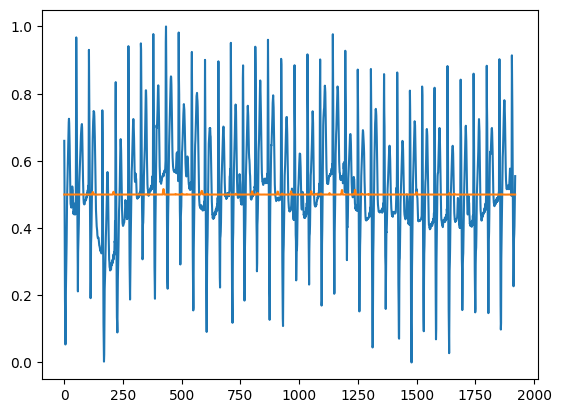

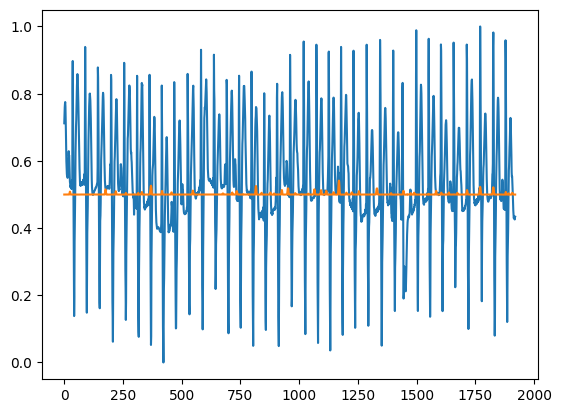

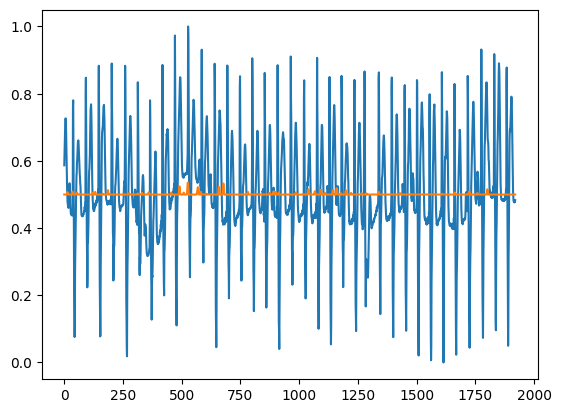

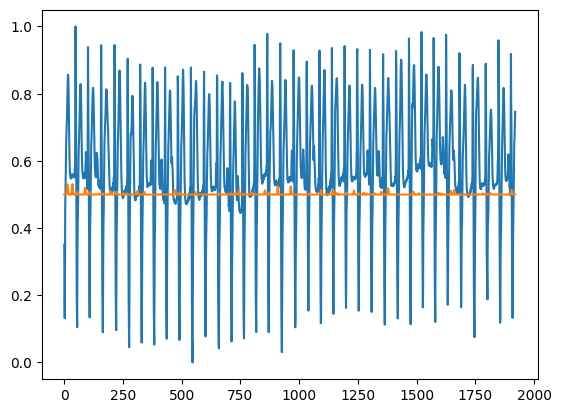

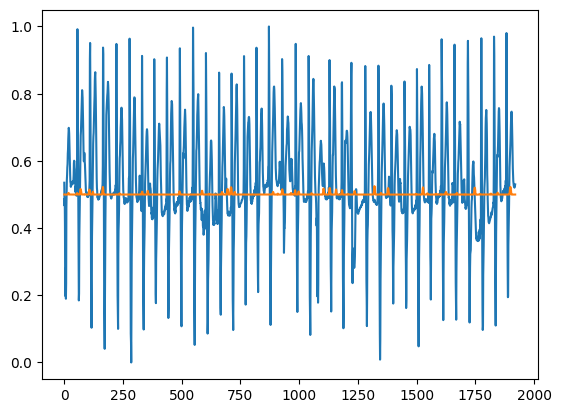

In [10]:


net.to(DEVICE)
for epoch in range(400):
    since = time.time()
    train_loss = 0.
    recon_loss = 0.
    elbo_loss = 0.
    for i_batch, (inputs, labels) in enumerate(data_loader_train):
        inputs = inputs.to(DEVICE)
        labels = labels.to(DEVICE)

        # print(f"inputs:{inputs.detach().cpu().numpy().shape}")

        optimizer.zero_grad()
        _, x_hat = net(inputs)
        # try:
        #     _, x_hat = net(inputs)
        # except Exception as e:            
        #     log(f"Exception in kfold, {str(e)}, caused by - \n{traceback.format_exc()}")
        #     continue
        # latent, x_hat, out_classif = net(inputs)
        # latent_ref, _, _ = net(x_ref)

        # # reconstruction loss
        # loss_recon = criteria_decoder(x_hat, inputs)
        # loss = loss_recon

        # elbo loss
        if is_vae:
            # loss_recon = net.gaussian_likelihood(x_hat, inputs)
            # elbo = (net.encoder.kl - loss_recon)
            # loss = elbo.mean()  #loss_recon
            
            # loss = loss_recon = ((inputs - x_hat)**2).sum() + net.encoder.kl

            loss_recon = 500 * criteria_decoder(x_hat.squeeze(1), inputs.squeeze(1))
            elbo = 1 * net.encoder.kl
            loss = loss_recon + elbo
            elbo_loss += elbo.detach().cpu().numpy()
        else:
            loss_recon = 500*criteria_decoder(x_hat.squeeze(1), inputs.squeeze(1))
            loss = loss_recon        

        # print(f"loss_recon:{loss_recon.detach().shape}, kl:{net.encoder.kl.shape}, elbo:{loss.shape}")

        recon_loss += loss_recon.detach().cpu().numpy()
        train_loss += loss.detach().cpu().numpy()
        # enc_d_loss += loss_enc_d.detach().cpu().numpy()


        loss.backward()
        optimizer.step()

        if i_batch == 0:
            viz_epoch_batch(epoch, inputs, x_hat, log_file.split('/')[-1][:-4])

        # scheduler.step()
    
    time_elapsed = time.time() - since
    train_loss = train_loss / len(data_loader_train)
    recon_loss = recon_loss / len(data_loader_train)
    elbo_loss = elbo_loss / len(data_loader_train)
    log(
        f"epoch:{epoch}, train_loss:{train_loss:.4f}, "
        f"recon_loss:{recon_loss:.4f}, elbo_loss:{elbo_loss:.4f}, "
        f"lr:{optimizer.param_groups[0]['lr']}, "
        f"time:{time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s")


In [11]:
# tm_sim_start = f"{datetime.now():%Y%m%d%H%M%S}"

# optimizer = torch.optim.Adam(net.parameters(), lr=0.0001)
# # criteria_decoder = nn.BCELoss()
# criteria_decoder = nn.MSELoss()
# # criteria_decoder = nn.L1Loss(reduction='sum')

# for epoch in range(200):
#     since = time.time()
#     train_loss = 0.
#     recon_loss = 0.
#     for i_batch, (inputs, labels) in enuymerate(data_loader_train):
#         # inputs = inputs.to(device)
#         labels = labels.to(DEVICE)
        
#         x_src, x_ref = inputs[:, :1], inputs[:, 1:2]
#         x_src = x_src.to(DEVICE)
#         x_ref = x_ref.to(DEVICE)

#         optimizer.zero_grad()
#         latent, x_hat, out_classif = net(x_src)
#         # latent_ref, _, _ = net(x_ref)

#         # # reconstruction loss
#         loss_recon = criteria_decoder(x_hat, x_src)
#         loss = loss_recon

#         # loss_recon = net.gaussian_likelihood(x_hat, x_src)
#         # elbo = (net.encoder.kl - loss_recon).mean()        
#         # loss = elbo  #loss_recon 

#         # loss = loss_recon = ((x_src - x_hat)**2).sum() + net.encoder.kl

#         recon_loss += loss_recon.detach().cpu().numpy()
#         train_loss += loss.detach().cpu().numpy()
#         # enc_d_loss += loss_enc_d.detach().cpu().numpy()

#         loss.backward()
#         optimizer.step()

#         if i_batch == 0:
#             viz_epoch_batch(epoch, x_src, x_hat, tm_sim_start)
    
#     time_elapsed = time.time() - since
#     train_loss = train_loss / len(data_loader_train)
#     recon_loss = recon_loss / len(data_loader_train)
#     print(
#         f"epoch:{epoch}, train_loss:{train_loss:.4f}, "
#         f"recon_loss:{recon_loss:.4f}, "
#         f"time:{time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s")
